In [1]:
%load_ext autoreload
%autoreload 2
# %cd /p/mmcardiac/Jerry/code/CINE-DENSE-Translation
%cd /home/jx8fh/Projects/LaMoD
import numpy as np
import torch
import matplotlib.pyplot as plt
from pathlib import Path
from modules.data import check_dict

/sfs/gpfs/tardis/home/jx8fh/Projects/LaMoD


In [2]:
strain_prev_filename = '/scratch/jx8fh/2024-04-24-whole-vol-preds-strain-and-errors.npy'
strain_prev_data = np.load(strain_prev_filename, allow_pickle=True).tolist()
check_dict(strain_prev_data)

MotionDecoder1x1                                             dict_keys(['strain_img_MSE_errors', 'strain_img_L1_errors', 'strain_mat_MSE_errors', 'strain_mat_L1_errors', 'DENSE_strain_CC_pred', 'DENSE_strain_segmental_pred'])
UNetROri                                                     dict_keys(['strain_img_MSE_errors', 'strain_img_L1_errors', 'strain_mat_MSE_errors', 'strain_mat_L1_errors', 'DENSE_strain_CC_pred', 'DENSE_strain_segmental_pred'])
UNetR1x1                                                     dict_keys(['strain_img_MSE_errors', 'strain_img_L1_errors', 'strain_mat_MSE_errors', 'strain_mat_L1_errors', 'DENSE_strain_CC_pred', 'DENSE_strain_segmental_pred'])
StrainNetOri                                                 dict_keys(['strain_img_MSE_errors', 'strain_img_L1_errors', 'strain_mat_MSE_errors', 'strain_mat_L1_errors', 'DENSE_strain_CC_pred', 'DENSE_strain_segmental_pred'])
StrainNet                                                    dict_keys(['strain_img_MSE_errors',

In [3]:
# strain_transUNet_filename = '/p/mmcardiac/Jerry/code/CINE-DENSE-Translation/review/2024-04/2024-04-24-whole-vol-preds/2024-04-24-whole-vol-preds-strain-and-errors.npy'
strain_transUNet_filename = '/scratch/jx8fh/2024-06-22-whole-vol-preds-strain-and-errors-TransUNet.npy'
strain_transUNet_data = np.load(strain_transUNet_filename, allow_pickle=True).tolist()
check_dict(strain_transUNet_data)

TransUNetOri                                                 dict_keys(['strain_img_MSE_errors', 'strain_img_L1_errors', 'strain_mat_MSE_errors', 'strain_mat_L1_errors', 'DENSE_strain_CC_pred', 'DENSE_strain_segmental_pred'])
TransUNet1x1                                                 dict_keys(['strain_img_MSE_errors', 'strain_img_L1_errors', 'strain_mat_MSE_errors', 'strain_mat_L1_errors', 'DENSE_strain_CC_pred', 'DENSE_strain_segmental_pred'])


In [4]:
test_GT_data = np.load('/scratch/jx8fh/2024-04-16-test-data.npy', allow_pickle=True).tolist()
check_dict(test_GT_data[0])

patient_id                                                   033                 
DENSE_slice_mat_filename                                     /p/miauva/data/Jerry/medical-images/Cardiac-FromKen/Yu-DENSE-data/033_S01_base_auto.1_ROI.1.mat
DENSE_slice_location                                         76.947609505431     
DENSE_frame_time_stamps                                      (51,)               
DENSE_Lag_displacement_field_X                               (48, 48, 51)        
DENSE_Lag_displacement_field_Y                               (48, 48, 51)        
DENSE_myo_masks                                              (48, 48, 51)        
DENSE_myo_mask_bbox                                          (34, 82, 40, 88)    
DENSE_myo_masks_rescaled                                     (128, 128, 51)      
DENSE_n_frames_all                                           51                  
DENSE_frame_indices_with_myo_contour                         (51,)               
out_of_box_flag        

In [5]:
len(test_GT_data)

102

/tmp/ipykernel_48280/324523574.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(1, 6, figsize=(20, 4))


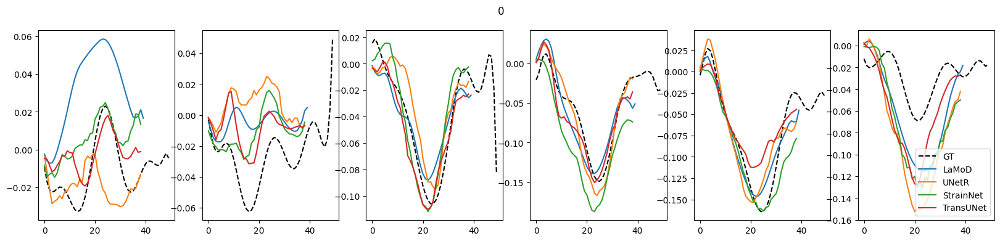

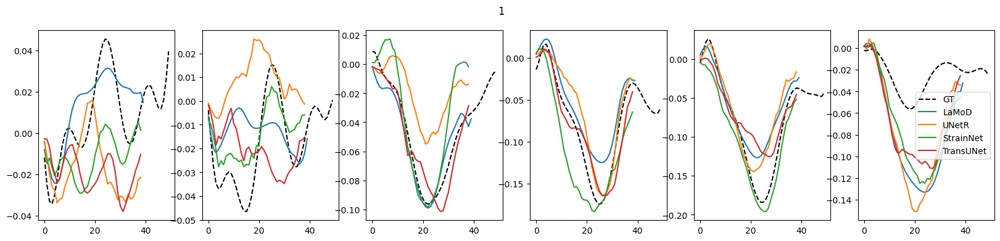

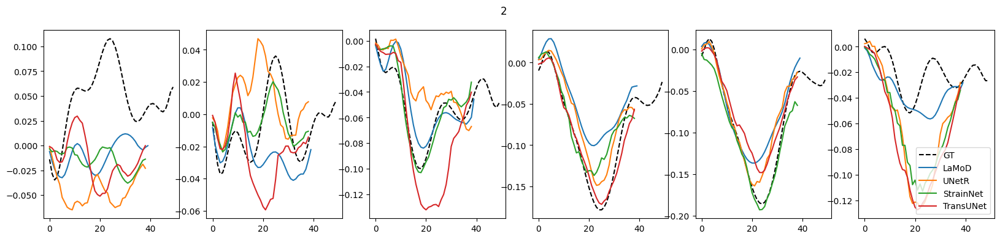

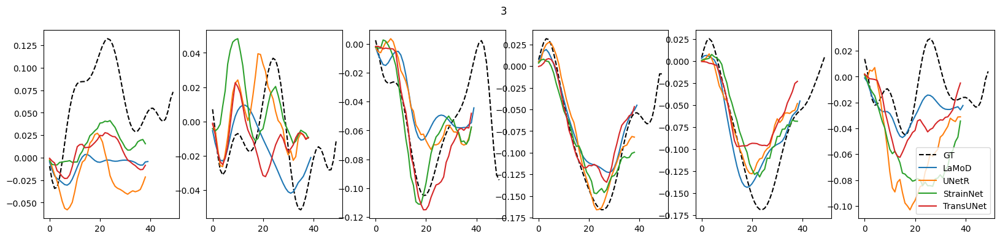

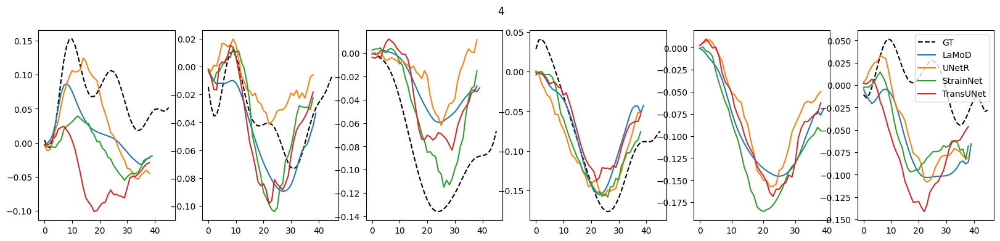

...

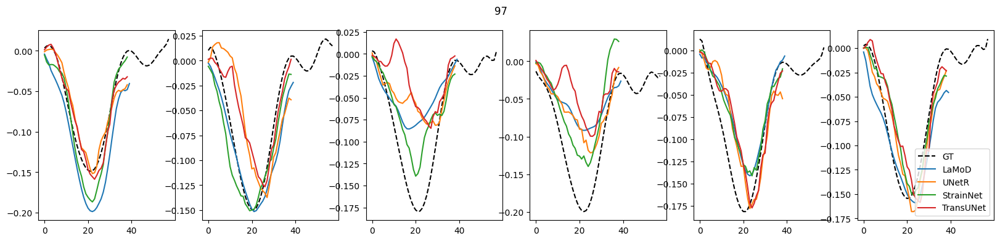

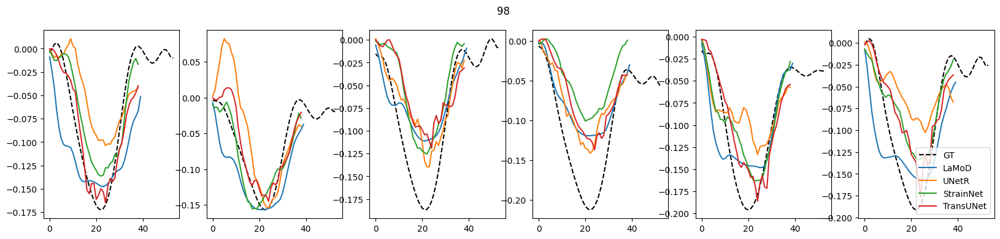

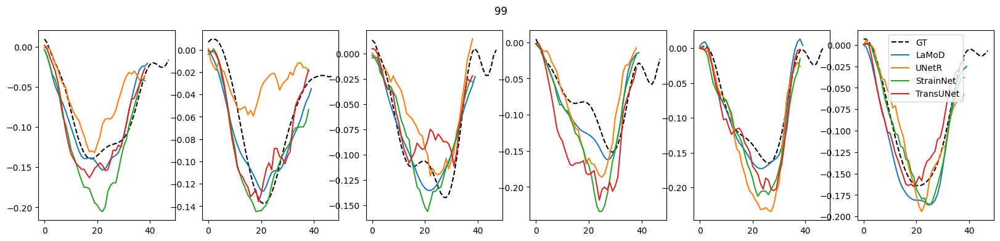

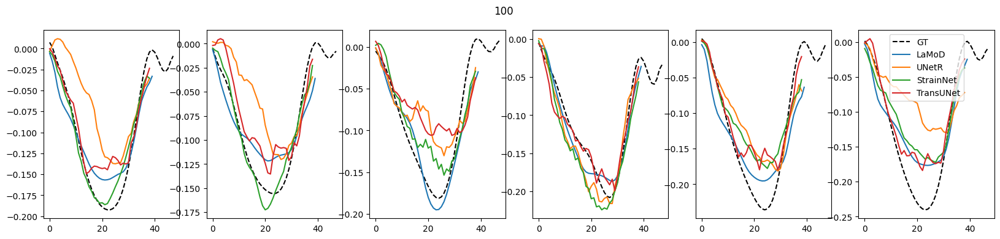

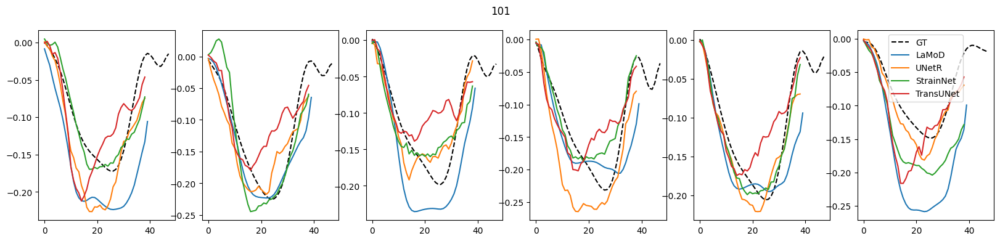

In [6]:
import os
save_one_row_dir = '/home/jx8fh/Projects/LaMoD/debug/notebooks/2025-01-06-plot-all-strain-curves/one-row'
for datum_idx in range(len(strain_prev_data['MotionDecoder1x1']['DENSE_strain_segmental_pred'])):
    fig, axs = plt.subplots(1, 6, figsize=(20, 4))
    for sector_idx in range(6):
        strain_curve_GT = test_GT_data[datum_idx]['DENSE_strain_CCs6'][sector_idx, :-1]
        strain_curve_MotionDecoder = strain_prev_data['MotionDecoder1x1']['DENSE_strain_segmental_pred'][datum_idx]['CCs6'][sector_idx]
        strain_curve_UNetR = strain_prev_data['UNetROri']['DENSE_strain_segmental_pred'][datum_idx]['CCs6'][sector_idx, :-1]
        strain_curve_StrainNet = strain_prev_data['StrainNetOri']['DENSE_strain_segmental_pred'][datum_idx]['CCs6'][sector_idx, :-1]
        strain_curve_TransUNet = strain_transUNet_data['TransUNetOri']['DENSE_strain_segmental_pred'][datum_idx]['CCs6'][sector_idx, :-1]

        axs[sector_idx].plot(strain_curve_GT, label='GT', linestyle='--', color='black')
        axs[sector_idx].plot(strain_curve_MotionDecoder, label='LaMoD')
        # axs[sector_idx].plot(strain_curve_MotionDecoder*1.5, label='LaMoD1.5')
        axs[sector_idx].plot(strain_curve_UNetR, label='UNetR')
        axs[sector_idx].plot(strain_curve_StrainNet, label='StrainNet')
        axs[sector_idx].plot(strain_curve_TransUNet, label='TransUNet')
    axs[-1].legend()
    fig.suptitle(f'{datum_idx}')
    # save figure
    fig.savefig(os.path.join(save_one_row_dir, f'{datum_idx}.png'))

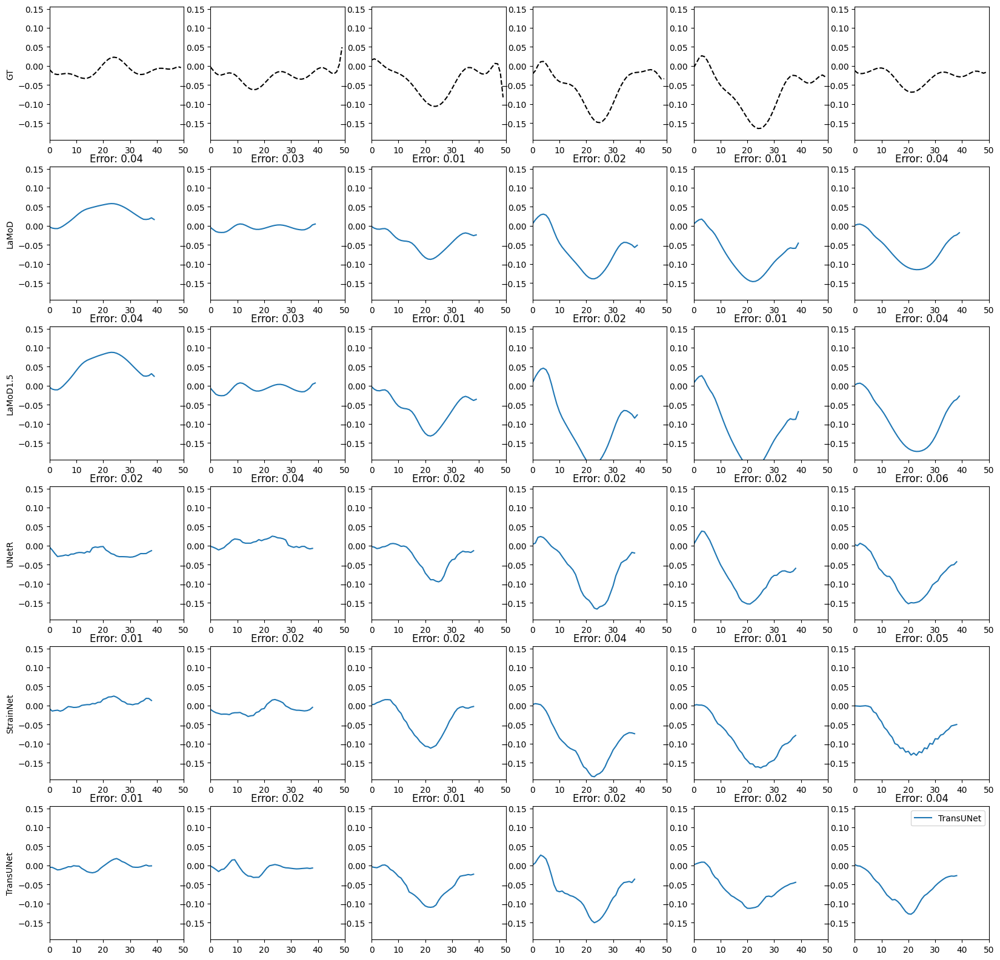

In [7]:
def compute_strain_curve_error(strain_curve_GT, strain_curve_pred):
    strain_curve_error = np.mean(np.abs(strain_curve_GT[:35] - strain_curve_pred[:35]))
    return strain_curve_error

for datum_idx in range(len(strain_prev_data['MotionDecoder1x1']['DENSE_strain_segmental_pred'])):
    fig, axs = plt.subplots(6, 6, figsize=(20, 20))
    for sector_idx in range(6):
        strain_curve_GT = test_GT_data[datum_idx]['DENSE_strain_CCs6'][sector_idx, :-1]
        strain_curve_MotionDecoder = strain_prev_data['MotionDecoder1x1']['DENSE_strain_segmental_pred'][datum_idx]['CCs6'][sector_idx]
        strain_curve_UNetR = strain_prev_data['UNetROri']['DENSE_strain_segmental_pred'][datum_idx]['CCs6'][sector_idx, :-1]
        strain_curve_StrainNet = strain_prev_data['StrainNetOri']['DENSE_strain_segmental_pred'][datum_idx]['CCs6'][sector_idx, :-1]
        strain_curve_TransUNet = strain_transUNet_data['TransUNetOri']['DENSE_strain_segmental_pred'][datum_idx]['CCs6'][sector_idx, :-1]

        strain_curve_MotionDecoder_error = compute_strain_curve_error(strain_curve_GT, strain_curve_MotionDecoder)
        strain_curve_UNetR_error = compute_strain_curve_error(strain_curve_GT, strain_curve_UNetR)
        strain_curve_StrainNet_error = compute_strain_curve_error(strain_curve_GT, strain_curve_StrainNet)
        strain_curve_TransUNet_error = compute_strain_curve_error(strain_curve_GT, strain_curve_TransUNet)

        axs[0, sector_idx].plot(strain_curve_GT, label='GT', linestyle='--', color='black')
        axs[1, sector_idx].plot(strain_curve_MotionDecoder, label='LaMoD'); axs[1, sector_idx].set_title(f'Error: {strain_curve_MotionDecoder_error:.2f}')
        axs[2, sector_idx].plot(strain_curve_MotionDecoder*1.5, label='LaMoD1.5'); axs[2, sector_idx].set_title(f'Error: {strain_curve_MotionDecoder_error:.2f}')
        axs[3, sector_idx].plot(strain_curve_UNetR, label='UNetR'); axs[3, sector_idx].set_title(f'Error: {strain_curve_UNetR_error:.2f}')
        axs[4, sector_idx].plot(strain_curve_StrainNet, label='StrainNet'); axs[4, sector_idx].set_title(f'Error: {strain_curve_StrainNet_error:.2f}')
        axs[5, sector_idx].plot(strain_curve_TransUNet, label='TransUNet'); axs[5, sector_idx].set_title(f'Error: {strain_curve_TransUNet_error:.2f}')
        for axe in axs[:, sector_idx]:
            axe.set_xlim([0, max(len(strain_curve_GT), len(strain_curve_MotionDecoder), len(strain_curve_UNetR), len(strain_curve_StrainNet), len(strain_curve_TransUNet))])
            axe.set_ylim([np.min(test_GT_data[datum_idx]['DENSE_strain_CCs6'])*1.05, np.max(test_GT_data[datum_idx]['DENSE_strain_CCs6'])*1.05])

        if sector_idx == 0:
            axs[0, sector_idx].set_ylabel('GT')
            axs[1, sector_idx].set_ylabel('LaMoD')
            axs[2, sector_idx].set_ylabel('LaMoD1.5')
            axs[3, sector_idx].set_ylabel('UNetR')
            axs[4, sector_idx].set_ylabel('StrainNet')
            axs[5, sector_idx].set_ylabel('TransUNet')
            # axs[0, sector_idx].set_title(f'Sector {sector_idx+1}')
    
    axs[-1,-1].legend()
    break